**Daftar Isi**

1.   Problem Statement 
2.   Data Cleaning and Preprocessing
3.   Exploratory Data Analysis
4.   Modelling
5.   Conclusion
6.   Daftar Pustaka





#**Problem Statement**


**Latar Belakang**





**Pada 31 Desember 2019**, pemerintah Wuhan menemukan beberapa pasien yang menderita pneumonia misterius. **Kemudian pada 13 Januari 2020**, kasus pertama pneumonia misterius serupa  terdeteksi di luar China, yakni Thailand, Jepang, dan Korea Selatan. Saat itu, beberapa negara  mulai menyandang risiko epidemi virus corona.Sebanyak lebih dari 570 kasus virus corona juga sudah terdeteksi di beberapa negara seperti Taiwan, Jepang, Thailand, Korea Selatan hingga Amerika Serikat. WHO pun akhirnya menamakan virus corona tersebut sebagai **COVID-19**. Akhirnya 9 hari setelah Indonesia mengumumkan kasus pertamanya, pihak WHO  mengumumkan bahwa covid-19 merupakan penyakit pandemi yang kasusnya telah **melunjak** pesat lebih dari 1 juta di seluruh dunia. 






Oleh sebab itu WHO selaku organisasi kesehatan dunia perlu mengambil langkah dalam melakukan penanganan untuk menangani persebaran dan dampak Covid-19. **Penanganan dapat WHO lakukan dengan melakukan prioritasi pemberian vaksin, bantuan kesehatan dalam bentuk alat kesehatan dan obat bagi negara yang paling terdampak kasus Covid-19 baik dari segi ekonomi,kesehatan,mobilitas, dan sosial.**


In [ ]:
!pip install pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


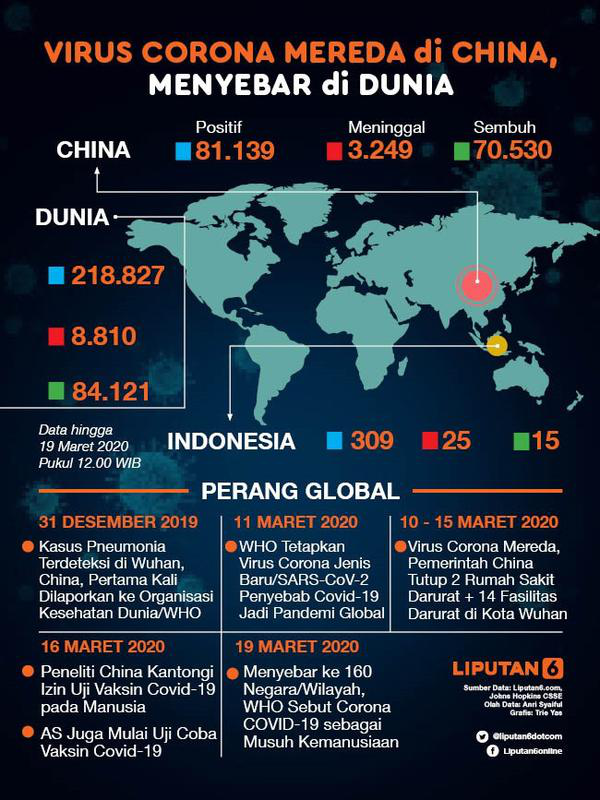

In [ ]:
#Memanggil gambar Timeline Covid-19 di Dunia
from urllib.request import urlopen
from PIL import Image

img_1 = Image.open(urlopen("https://cdn0-production-images-kly.akamaized.net/MOY1Ysd4EaPUf-i2N59rSaiKEQM=/600x800/smart/filters:quality(75):strip_icc():format(jpeg)/kly-media-production/medias/3081111/original/079804300_1584622604-Infografis_virus_corona_menyebar_ke_dunia.jpg"))
img_1

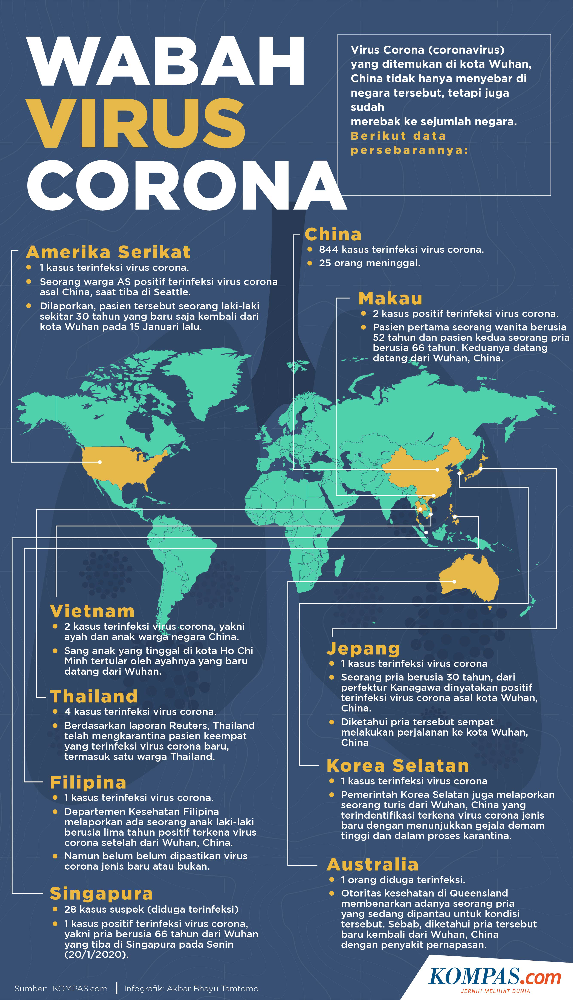

In [ ]:
# Memanggil gambar peta sebaran Covid-19 di dunia
from urllib.request import urlopen
from PIL import Image

img = Image.open(urlopen("https://asset.kompas.com/data/photo/2020/01/24/5e2a4f10bbf57.jpg"))
img

**Masalah yang perlu diatasi WHO**

WHO sebagai lembaga kesehatan dunia perlu bertindak cepat untuk memberikan bantuan yang adil dan tepat bagi setiap negara yang terpapar COVID. Oleh karena itu perlu bantuan data analysis dan machine learning agar bantuan yang disalurkan dapat sesuai yang dibutuhkan tiap negara.

# **Data Cleaning and Preprocessing**

In [ ]:
#Import Library utama
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
import datetime as dt
from datetime import timedelta

#Import Library untuk Modelling
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score,silhouette_samples



In [ ]:
#Load dataset yang akan digunakkan
url='https://drive.google.com/file/d/1PDPaq_0mO1tepYrfdJvA4lJS5o5XWB90/view?usp=sharing'
url='https://drive.google.com/uc?id=' + url.split('/')[-2]
df = pd.read_csv(url)

In [ ]:
#Mengecek apakah data sudah berhasil dibaca
df.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0.0,0.0,0.0


In [ ]:
# Membaca info pada dataset berupa nama kolom, jumlah baris yang terisi, dan jenis variabel pada tiap kolom
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306429 entries, 0 to 306428
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   SNo              306429 non-null  int64  
 1   ObservationDate  306429 non-null  object 
 2   Province/State   228329 non-null  object 
 3   Country/Region   306429 non-null  object 
 4   Last Update      306429 non-null  object 
 5   Confirmed        306429 non-null  float64
 6   Deaths           306429 non-null  float64
 7   Recovered        306429 non-null  float64
dtypes: float64(3), int64(1), object(4)
memory usage: 18.7+ MB


**Cleaning Data**

In [ ]:
#Mengecek size dan shape  data pada dataset Covid-19
print("Size/Shape dari dataset: ",df.shape)

#Mengecek jumlah missing value yang terdapat pada dataset Covid-19
print(" Jumlah Missing values:\n",df.isnull().sum())

Size/Shape dari dataset:  (306429, 8)
 Jumlah Missing values:
 SNo                    0
ObservationDate        0
Province/State     78100
Country/Region         0
Last Update            0
Confirmed              0
Deaths                 0
Recovered              0
dtype: int64


In [ ]:
# Karena missing value cukup banyak dan terdapat pada province/state yang mempunyai ikatan dengan country. 
# Hal ini membuat kolom tidak bisa diimputasi dengan modus karena  maka kolom perlu dihapus
df.drop(["Province/State"],1,inplace=True)

#SNo juga karena tidak diperlukan dalam pengolahan data maka kolomnya akan dihapus
df.drop(["SNo"],1,inplace=True)

In [ ]:
#Melihat Hasil Data Cleaning
df.head()

,ObservationDate,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,01/22/2020,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
1,01/22/2020,Mainland China,1/22/2020 17:00,14.0,0.0,0.0
2,01/22/2020,Mainland China,1/22/2020 17:00,6.0,0.0,0.0
3,01/22/2020,Mainland China,1/22/2020 17:00,1.0,0.0,0.0
4,01/22/2020,Mainland China,1/22/2020 17:00,0.0,0.0,0.0


**Preprocessing Data**

In [ ]:
# Mengubah kolom ObservationDate menjadi format Datetime agar dapat dianalisis waktunya
df["ObservationDate"]=pd.to_datetime(df["ObservationDate"])


In [ ]:
# Melakukan grupping  setiap country  agar dapat dihitung jumlah masyarakat yang terpapar (confirmed)
# masyarakat yang berhasil sembuh (Recovered), dan masyarakat yang meninggal (Deaths) 

grouped_country=df.groupby(["Country/Region","ObservationDate"]).agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'})

In [ ]:
#Melakukan grouping pada masyarakat setiap country (negara) 
#berdasarkan kasus yang masih aktif dan yang baru terkonfirmasi
grouped_country["Active Cases"]=grouped_country["Confirmed"]-grouped_country["Recovered"]-grouped_country["Deaths"]
grouped_country["log_confirmed"]=np.log(grouped_country["Confirmed"])
grouped_country["log_active"]=np.log(grouped_country["Active Cases"])

In [ ]:
df[df["Country/Region"] == "Indonesia"].head(10)

,ObservationDate,Country/Region,Last Update,Confirmed,Deaths,Recovered
3114,03/02/2020,Indonesia,2020-03-02T18:03:04,2.0,0.0,0.0
3258,03/03/2020,Indonesia,2020-03-02T18:03:04,2.0,0.0,0.0
3421,03/04/2020,Indonesia,2020-03-02T18:03:04,2.0,0.0,0.0
3590,03/05/2020,Indonesia,2020-03-02T18:03:04,2.0,0.0,0.0
3760,03/06/2020,Indonesia,2020-03-06T12:33:03,4.0,0.0,0.0
3968,03/07/2020,Indonesia,2020-03-06T12:33:03,4.0,0.0,0.0
4194,03/08/2020,Indonesia,2020-03-08T10:03:13,6.0,0.0,0.0
4420,03/09/2020,Indonesia,2020-03-09T11:33:10,19.0,0.0,0.0
4686,03/10/2020,Indonesia,2020-03-10T12:53:02,27.0,0.0,2.0
4896,03/11/2020,Indonesia,2020-03-11T11:14:26,34.0,1.0,2.0


In [ ]:
Asean_data=df[df["Country/Region"]=="Indonesia"]
datewise_indonesia=indonesia_data.groupby(["ObservationDate"]).agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'})
print(datewise_indonesia.iloc[-1])

Confirmed    743198.0
Recovered    611097.0
Deaths        22138.0
Name: 12/31/2020, dtype: float64


# **Exploratory Data Analysis**

 **A.Eksplorasi dan analisis data Covid dunia berdasarkan waktu**

In [ ]:
# Melakuka Grouping berbagai jenis kasus Covid berdasarkan rentang waktu yang ada
datewise=df.groupby(["ObservationDate"]).agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'})
datewise["Days Since"]=datewise.index-datewise.index.min()


In [ ]:
# Menampilkan berbagai informasi jenis kasus diseluruh dunia berdasarkan kasus yang ada 
print("Berbagai Informasi berdasarkan satuan waktu")
print("Jumlah total negara dengan Penyebaran Penyakit: ",len(df["Country/Region"].unique()))
print("Jumlah Total Kasus Terkonfirmasi di Seluruh Dunia: ",datewise["Confirmed"].iloc[-1])
print("Jumlah Total Kasus yang sudah sembuh di Seluruh Dunia: ",datewise["Recovered"].iloc[-1])
print("Jumlah Total Kasus Kematian di Seluruh Dunia: ",datewise["Deaths"].iloc[-1])
print("Jumlah Total Kasus Aktif di Seluruh Dunia: ",(datewise["Confirmed"].iloc[-1]-datewise["Recovered"].iloc[-1]-datewise["Deaths"].iloc[-1]))
print("Jumlah Total Kasus yang sudah ditutup di Seluruh Dunia: ",datewise["Recovered"].iloc[-1]+datewise["Deaths"].iloc[-1])
print("Perkiraan jumlah Kasus Terkonfirmasi per Hari di Seluruh Dunia: ",np.round(datewise["Confirmed"].iloc[-1]/datewise.shape[0]))
print("Perkiraan jumlah Kasus yang Dipulihkan per Hari di Seluruh Dunia: ",np.round(datewise["Recovered"].iloc[-1]/datewise.shape[0]))
print("Perkiraan jumlah Kasus Kematian per Hari di Seluruh Dunia: ",np.round(datewise["Deaths"].iloc[-1]/datewise.shape[0]))
print("Perkiraan jumlah Kasus Terkonfirmasi per jam di seluruh Dunia: ",np.round(datewise["Confirmed"].iloc[-1]/((datewise.shape[0])*24)))
print("Perkiraan jumlah Kasus yang sudah disembuhkan per jam di seluruh Dunia: ",np.round(datewise["Recovered"].iloc[-1]/((datewise.shape[0])*24)))
print("Perkiraan jumlah Kasus Kematian per jam di seluruh Dunia: ",np.round(datewise["Deaths"].iloc[-1]/((datewise.shape[0])*24)))
print("Jumlah Kasus Terkonfirmasi dalam 24 jam terakhir: ",datewise["Confirmed"].iloc[-1]-datewise["Confirmed"].iloc[-2])
print("Jumlah Kasus yang disembuhkan dalam 24 jam terakhir: ",datewise["Recovered"].iloc[-1]-datewise["Recovered"].iloc[-2])
print("Jumlah Kasus Kematian dalam 24 jam terakhir: ",datewise["Deaths"].iloc[-1]-datewise["Deaths"].iloc[-2])

Berbagai Informasi berdasarkan satuan waktu
Jumlah total negara dengan Penyebaran Penyakit:  229
Jumlah Total Kasus Terkonfirmasi di Seluruh Dunia:  169951560.0
Jumlah Total Kasus yang sudah sembuh di Seluruh Dunia:  107140669.0
Jumlah Total Kasus Kematian di Seluruh Dunia:  3533619.0
Jumlah Total Kasus Aktif di Seluruh Dunia:  59277272.0
Jumlah Total Kasus yang sudah ditutup di Seluruh Dunia:  110674288.0
Perkiraan jumlah Kasus Terkonfirmasi per Hari di Seluruh Dunia:  344031.0
Perkiraan jumlah Kasus yang Dipulihkan per Hari di Seluruh Dunia:  216884.0
Perkiraan jumlah Kasus Kematian per Hari di Seluruh Dunia:  7153.0
Perkiraan jumlah Kasus Terkonfirmasi per jam di seluruh Dunia:  14335.0
Perkiraan jumlah Kasus yang sudah disembuhkan per jam di seluruh Dunia:  9037.0
Perkiraan jumlah Kasus Kematian per jam di seluruh Dunia:  298.0
Jumlah Kasus Terkonfirmasi dalam 24 jam terakhir:  480835.0
Jumlah Kasus yang disembuhkan dalam 24 jam terakhir:  507600.0
Jumlah Kasus Kematian dalam 24 ja

In [ ]:
# Distribusi jumlah kasus yang baru terkonfirmasi per rentang waktu dari awal hingga akhir tanggal dataset
fig=px.bar(x=datewise.index,y=datewise["Confirmed"])
fig.update_layout(title="Distribusi Jumlah Kasus yang Terkonfirmasi Positif",
                  xaxis_title="Tanggal",yaxis_title="Jumlah Kasus yang Terkonfirmasi Positif",)
fig.show()

In [ ]:
# Distribusi jumlah kasus pasien yang sudah sembuh per rentang waktu dari awal hingga akhir tanggal dataset
fig=px.bar(x=datewise.index,y=datewise["Recovered"])
fig.update_layout(title="Distribusi Jumlah kasus pasien yang sudah sembuh",
                  xaxis_title="Tanggal",yaxis_title="Jumlah Kasus yang yang sudah sembuh",)
fig.show()

In [ ]:
# Distribusi jumlah kasus pasien meninggal per rentang waktu dari awal hingga akhir tanggal dataset
fig=px.bar(x=datewise.index,y=datewise["Deaths"])
fig.update_layout(title="Distribusi Jumlah kasus pasien yang meninggal",
                  xaxis_title="Tanggal",yaxis_title="Jumlah Kasus yang meninggal",)
fig.show()

In [ ]:
# Distribusi jumlah kasus Aktif per rentang waktu dari awal hingga akhir tanggal dataset
fig=px.bar(x=datewise.index,y=datewise["Confirmed"]-datewise["Recovered"]-datewise["Deaths"])
fig.update_layout(title="Distribusi Jumlah Kasus yang Aktif",
                  xaxis_title="Tanggal",yaxis_title="Jumlah Kasus yang aktif",)
fig.show()

Peningkatan jumlah kasus aktif merupakan indikasi bahwa kasus Sembuh atau kasus Kematian menurun dibandingkan dengan jumlah Kasus yang terkonfirmasi positif secara drastis. 

In [ ]:
# Distribusi jumlah kasus yang sudah ditutup per rentang waktu dari awal hingga akhir tanggal dataset
fig=px.bar(x=datewise.index,y=datewise["Recovered"]+datewise["Deaths"])
fig.update_layout(title="Distribusi Jumlah Kasus yang Ditutup",
                  xaxis_title="Tanggal",yaxis_title="Jumlah Kasus")
fig.show()

Peningkatan jumlah kasus yang ditutup merupakan pertanda bahwa  lebih banyak pasien yang sembuh dari penyakit atau lebih banyak orang meninggal karena COVID-19

In [ ]:
# Pertumbuhan kasus yang terkonfirmasi positif,disembuhkan,dan meninggal perminggunya
datewise["WeekOfYear"]=datewise.index.weekofyear

week_num=[]
weekwise_confirmed=[]
weekwise_recovered=[]
weekwise_deaths=[]
w=1
for i in list(datewise["WeekOfYear"].unique()):
    weekwise_confirmed.append(datewise[datewise["WeekOfYear"]==i]["Confirmed"].iloc[-1])
    weekwise_recovered.append(datewise[datewise["WeekOfYear"]==i]["Recovered"].iloc[-1])
    weekwise_deaths.append(datewise[datewise["WeekOfYear"]==i]["Deaths"].iloc[-1])
    week_num.append(w)
    w=w+1

fig=go.Figure()
fig.add_trace(go.Scatter(x=week_num, y=weekwise_confirmed,
                    mode='lines+markers',
                    name='Pertumbuhan kasus yang terkonfirmasi positif'))
fig.add_trace(go.Scatter(x=week_num, y=weekwise_recovered,
                    mode='lines+markers',
                    name='Pertumbuhan kasus sembuh/minggu'))
fig.add_trace(go.Scatter(x=week_num, y=weekwise_deaths,
                    mode='lines+markers',
                    name='Pertumbuhan kasus kematian/minggu'))
fig.update_layout(title="Pertumbuhan 3 tipe kasus di dunia setiap minggunya",
                 xaxis_title="Minggu",yaxis_title="Jumlah Kasus",legend=dict(x=0,y=1,traceorder="normal"))
fig.show()

Berdasarkan diagram dapat diketahui bahwa pada minggu ke-20 setelah covid terjadi terjadi penurunan jumlah kasus dengan pasien yang terkonfirmasi positif. Hal yang tidak disangka terjadi dimana pada minggu ke-20 diatas terjadi kenaikan masyarakat yang terpapar covid dengan cukup drastis hinggu minggu ke-50.


**Mencari Moralitas dan Tingkat pemulihan masyarakat dunia atas covid-19**

In [ ]:
#Menghitung presentase moralitas dan tingkat pemulihan masyarakat dunia
datewise["Mortality Rate"]=(datewise["Deaths"]/datewise["Confirmed"])*100
datewise["Recovery Rate"]=(datewise["Recovered"]/datewise["Confirmed"])*100
datewise["Active Cases"]=datewise["Confirmed"]-datewise["Recovered"]-datewise["Deaths"]
datewise["Closed Cases"]=datewise["Recovered"]+datewise["Deaths"]

print("Average Mortality Rate",datewise["Mortality Rate"].mean())
print("Median Mortality Rate",datewise["Mortality Rate"].median())
print("Average Recovery Rate",datewise["Recovery Rate"].mean())
print("Median Recovery Rate",datewise["Recovery Rate"].median())


Average Mortality Rate 3.398557417508881
Median Mortality Rate 2.772038814120292
Average Recovery Rate 51.148201824468615
Median Recovery Rate 56.426751740200025


In [ ]:
# Melakukan hasil presentase moralitas dan tingkat pemulihan masyarakat dunia
fig = make_subplots(rows=2, cols=1,
                   subplot_titles=("Recovery Rate", "Mortatlity Rate"))
fig.add_trace(
    go.Scatter(x=datewise.index, y=(datewise["Recovered"]/datewise["Confirmed"])*100,name="Recovery Rate"),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(x=datewise.index, y=(datewise["Deaths"]/datewise["Confirmed"])*100,name="Mortality Rate"),
    row=2, col=1
)
fig.update_layout(height=1000,legend=dict(x=-0.1,y=1.2,traceorder="normal"))
fig.update_xaxes(title_text="Date", row=1, col=1)
fig.update_yaxes(title_text="Recovery Rate", row=1, col=1)
fig.update_xaxes(title_text="Date", row=1, col=2)
fig.update_yaxes(title_text="Mortality Rate", row=1, col=2)
fig.show()

Jumlah pemulihan masyarakat atas covid meningkat pada beberap arentang waktu kedepan menandakan bahwa pasien mayoritas sudah mampu sembuh dari penyakit. Sedangkan pada grafik mortality sudah menurun artinya persentase pasien yang meninggal sudah menurun dibanding yang lalu. 

Visualisasi Animasi Kasus persetiap satuan waktu

In [ ]:
fig = px.choropleth(df, locations="Country/Region", 
                    color=np.log(df["Confirmed"]),
                    locationmode='country names', hover_name="Country/Region", 
                    animation_frame=df["ObservationDate"].dt.strftime('%Y-%m-%d'),
                    title='Kasus di dunia perhari-nya', color_continuous_scale=px.colors.sequential.matter)
fig.update(layout_coloraxis_showscale=False)
fig.show()

**B.Analisis dan Eksplorasi data berdasarkan negara**

In [ ]:
#Menghitung 50 negara dengan persentase mortalitas dan pemulihan 
countrywise=df[df["ObservationDate"]==df["ObservationDate"].max()].groupby(["Country/Region"]).agg({"Confirmed":'sum',"Recovered":'sum',"Deaths":'sum'}).sort_values(["Confirmed"],ascending=False)
countrywise["Mortality"]=(countrywise["Deaths"]/countrywise["Confirmed"])*100
countrywise["Recovery"]=(countrywise["Recovered"]/countrywise["Confirmed"])*100


Text(0.5, 1.0, '10 negara teratas sesuai Jumlah Kasus yang meninggal')

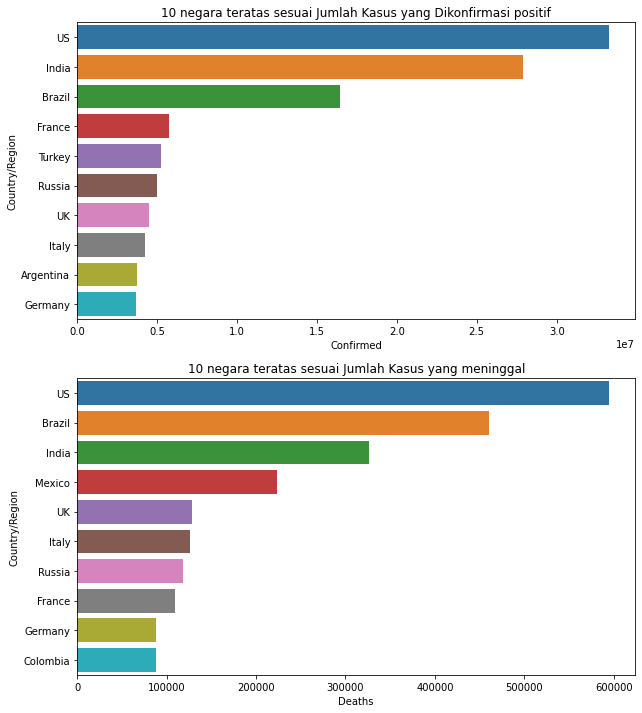

In [ ]:
#Menghitung 50 negara dengan jumlah kasus terkonfirmasi positif dam kasus meninggal terbanyak
fig, (ax1, ax2) = plt.subplots(2, 1,figsize=(10,12))
top_10_confirmed=countrywise.sort_values(["Confirmed"],ascending=False).head(10)
top_10_deaths=countrywise.sort_values(["Deaths"],ascending=False).head(10)
sns.barplot(x=top_10_confirmed["Confirmed"],y=top_10_confirmed.index,ax=ax1)
ax1.set_title("10 negara teratas sesuai Jumlah Kasus yang Dikonfirmasi positif")
sns.barplot(x=top_10_deaths["Deaths"],y=top_10_deaths.index,ax=ax2)
ax2.set_title("10 negara teratas sesuai Jumlah Kasus yang meninggal")

Berdasarkan data ini dapat dilihat bahwa Amerika serikat merupakan negara yang paling banyak masyarakatnya terpapar sekaligus yang jumlah meninggalnya paling besar

Text(0.5, 0, 'Recovery (in Percentage)')

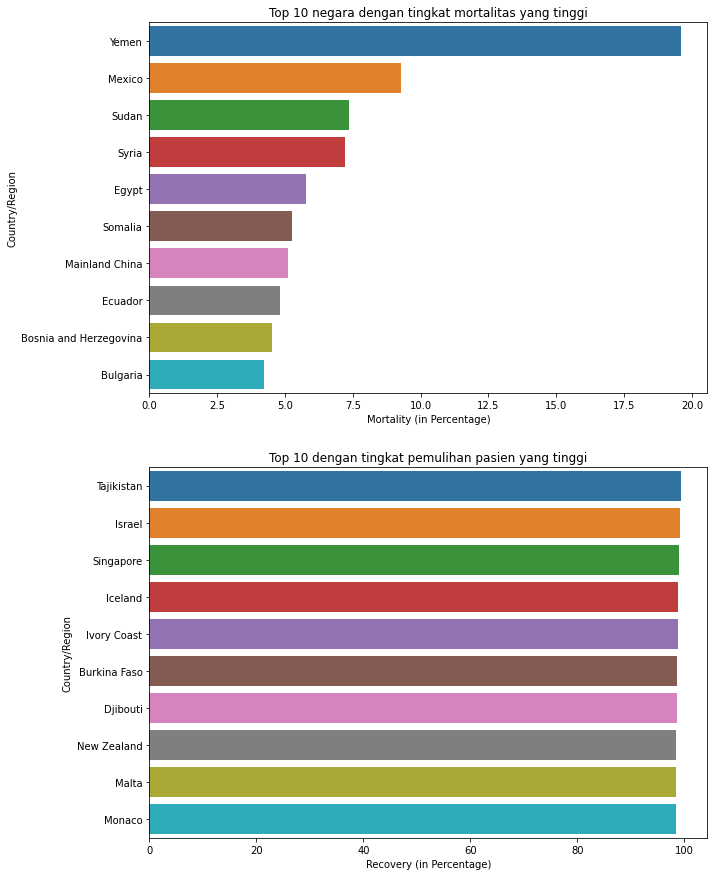

In [ ]:
#Mencari 10 negara dengan tingkat mortalitas dan pemulihan pasien yang tinggi
fig, (ax1, ax2) = plt.subplots(2, 1,figsize=(10,15))
countrywise_plot_mortal=countrywise[countrywise["Confirmed"]>500].sort_values(["Mortality"],ascending=False).head(10)
sns.barplot(x=countrywise_plot_mortal["Mortality"],y=countrywise_plot_mortal.index,ax=ax1)
ax1.set_title("Top 10 negara dengan tingkat mortalitas yang tinggi")
ax1.set_xlabel("Mortality (in Percentage)")
countrywise_plot_recover=countrywise[countrywise["Confirmed"]>500].sort_values(["Recovery"],ascending=False).head(10)
sns.barplot(x=countrywise_plot_recover["Recovery"],y=countrywise_plot_recover.index, ax=ax2)
ax2.set_title("Top 10 dengan tingkat pemulihan pasien yang tinggi")
ax2.set_xlabel("Recovery (in Percentage)")

Text(0.5, 0, 'Recovery (in Percentage)')

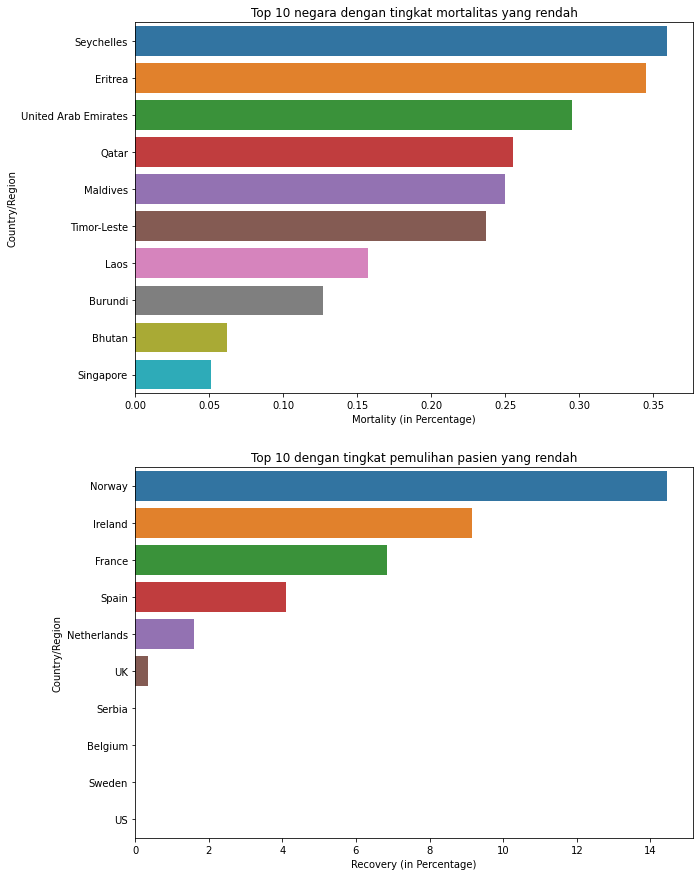

In [ ]:
#Mencari top 10 negara dengan mortalitas dan pemulihan pasien yang rendah
fig, (ax1, ax2) = plt.subplots(2, 1,figsize=(10,15))
countrywise_plot_mortal=countrywise[countrywise["Confirmed"]>500].sort_values(["Mortality"],ascending=False).tail(10)
sns.barplot(x=countrywise_plot_mortal["Mortality"],y=countrywise_plot_mortal.index,ax=ax1)
ax1.set_title("Top 10 negara dengan tingkat mortalitas yang rendah")
ax1.set_xlabel("Mortality (in Percentage)")
countrywise_plot_recover=countrywise[countrywise["Confirmed"]>500].sort_values(["Recovery"],ascending=False).tail(10)
sns.barplot(x=countrywise_plot_recover["Recovery"],y=countrywise_plot_recover.index, ax=ax2)
ax2.set_title("Top 10 dengan tingkat pemulihan pasien yang rendah")
ax2.set_xlabel("Recovery (in Percentage)")

Berdasarkan visualisasi disini kita dapat mengetahui bahwa **Tajikistan** merupakan dengan tingkat pemulihan pasien yang paling baik. Sedangkan yaman merupakn negara yang paling harus diperhatikan karena molaritas/kematiannya akibat covid merupakan yang paling tinggi.

# **Modelling**

Agar WHO dapat membuat bantuan yang tepat pada setiap negara  yang terpapar covid secara adil maka dalam pemilihan target harus dibagi menjadi beberapa kelompok negara. Pembagian negara dilakukan berdasarkan tingkat mortalitas dan pemulihan pasien (recovery) pada setiap negara.Hal ini diharapkan agar bantuan dari WHO mulai dari Vaksin hingga ventilator dapat tepat sasaran.

**Mortalitas dapat menggambarkan persentase  pasien terkonfirmasi positif yang meninggal.Semakin negara memiliki mortalitas yang tinggi maka perlu mendapati perhatian khusus dari WHO.**

**Sedangkan Recovery / pemulihan menggambarkan tingkat pasien terkonfirmasi positif yang berhasil sembuh. Negara yang memiliki recovery tinggi disini perlu dikurangi atau ditiadakan bantuannya dari WHO agar dapat fokus di negara dengan negara  yang recoverynya rendah.**

**Proses pengelompokkan negara  dilakukan dengan menggunakan data lewat metode clustering K-Means.**

In [ ]:
#Membuat tabel baru untuk clustering berdasarkan mortalitas dan klustering
X=countrywise[["Mortality","Recovery"]]
#Standard Scaling since K-Means Clustering is a distance based alogrithm
X=std.fit_transform(X) 

In [ ]:
wcss=[]
sil=[]
for i in range(2,11):
    clf=KMeans(n_clusters=i,init='k-means++',random_state=42)
    clf.fit(X)
    labels=clf.labels_
    centroids=clf.cluster_centers_
    sil.append(silhouette_score(X, labels, metric='euclidean'))
    wcss.append(clf.inertia_)

Text(0.5, 1.0, 'Elbow Method')

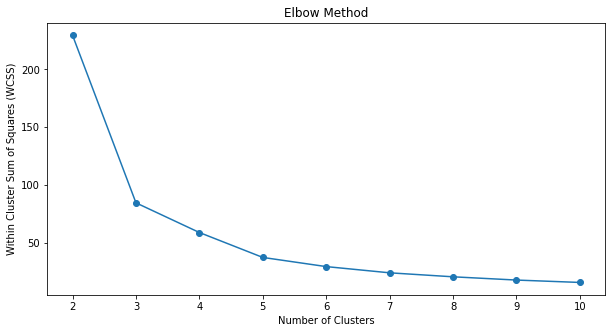

In [ ]:
#Mengecek hasil clustering elbow method terbaik
x=np.arange(2,11)
plt.figure(figsize=(10,5))
plt.plot(x,wcss,marker='o')
plt.xlabel("Number of Clusters")
plt.ylabel("Within Cluster Sum of Squares (WCSS)")
plt.title("Elbow Method")

Berdasarkan hasil elbow method diketahui bahwa pengelompokkan tiap negara berdasarkan mortalitas dan recovery merupakan **3 cluster**

In [ ]:
#Melakukan Clustering dengan algoritma K-means
clf_final=KMeans(n_clusters=3,init='k-means++',random_state=11)
clf_final.fit(X)

KMeans(n_clusters=3, random_state=11)

In [ ]:
countrywise["Clusters"]=clf_final.predict(X)

In [ ]:
cluster_summary=pd.concat([countrywise[countrywise["Clusters"]==1].head(15),countrywise[countrywise["Clusters"]==2].head(15),countrywise[countrywise["Clusters"]==0].head(15)])
cluster_summary.style.background_gradient(cmap='rainbow').format("{:.2f}")

,Confirmed,Recovered,Deaths,Mortality,Recovery,Clusters
Country/Region,,,,,,
US,33251939.00,0.00,594306.00,1.79,0.00,1.00
France,5719877.00,390878.00,109518.00,1.91,6.83,1.00
UK,4496823.00,15481.00,128037.00,2.85,0.34,1.00
Spain,3668658.00,150376.00,79905.00,2.18,4.10,1.00
Netherlands,1671967.00,26810.00,17889.00,1.07,1.60,1.00
Sweden,1068473.00,0.00,14451.00,1.35,0.00,1.00
Belgium,1059763.00,0.00,24921.00,2.35,0.00,1.00
Serbia,712046.00,0.00,6844.00,0.96,0.00,1.00
Switzerland,693023.00,317600.00,10805.00,1.56,45.83,1.00


In [ ]:
# Mencari mean moralitas dan recovery/pemulihan pada tiap-tiap cluster
print("Rata-Rata tingkat Mortalitas  Cluster 0: ",countrywise[countrywise["Clusters"]==0]["Mortality"].mean())
print("Rata-Rata tingkat Recovery Cluster 0: ",countrywise[countrywise["Clusters"]==0]["Recovery"].mean())
print("Rata-Rata tingkat Mortalitas Cluster 1: ",countrywise[countrywise["Clusters"]==1]["Mortality"].mean())
print("Rata-rata tingkat Recovery   Cluster 1: ",countrywise[countrywise["Clusters"]==1]["Recovery"].mean())
print("Rata-rata tingkat Mortalitas Cluster 2: ",countrywise[countrywise["Clusters"]==2]["Mortality"].mean())
print("Rata-rata tingkat Recovery  Cluster 2: ",countrywise[countrywise["Clusters"]==2]["Recovery"].mean())

Rata-Rata tingkat Mortalitas  Cluster 0:  1.877885707521883
Rata-Rata tingkat Recovery Cluster 0:  90.74888221767141
Rata-Rata tingkat Mortalitas Cluster 1:  1.701640341180339
Rata-rata tingkat Recovery   Cluster 1:  22.335095583921884
Rata-rata tingkat Mortalitas Cluster 2:  22.272707263793283
Rata-rata tingkat Recovery  Cluster 2:  67.75849166652911


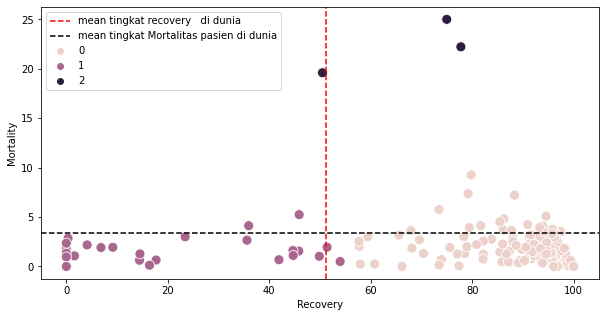

In [ ]:
plt.figure(figsize=(10,5))
sns.scatterplot(x=countrywise["Recovery"],y=countrywise["Mortality"],hue=countrywise["Clusters"],s=100)
plt.axvline(((datewise["Recovered"]/datewise["Confirmed"])*100).mean(),
            color='red',linestyle="--",label="mean tingkat recovery   di dunia")
plt.axhline(((datewise["Deaths"]/datewise["Confirmed"])*100).mean(),
            color='black',linestyle="--",label="mean tingkat Mortalitas pasien di dunia")
plt.legend()

In [ ]:
# Cluster pada tiap-tiap negara
print("Negara yang merupakan bagian dari Cluster 0: ",list(countrywise[countrywise["Clusters"]==0].head(201).index))
print("Negara yang merupakan bagian dari Cluster 1: ",list(countrywise[countrywise["Clusters"]==1].head(25).index))
print("Negara yang merupakan bagian dari Cluster 2: ",list(countrywise[countrywise["Clusters"]==2].head(3).index))

Negara yang merupakan bagian dari Cluster 0:  ['India', 'Brazil', 'Turkey', 'Russia', 'Italy', 'Argentina', 'Germany', 'Colombia', 'Iran', 'Poland', 'Mexico', 'Ukraine', 'Peru', 'Indonesia', 'Czech Republic', 'South Africa', 'Canada', 'Chile', 'Philippines', 'Iraq', 'Romania', 'Pakistan', 'Portugal', 'Israel', 'Hungary', 'Bangladesh', 'Japan', 'Jordan', 'Austria', 'United Arab Emirates', 'Malaysia', 'Nepal', 'Lebanon', 'Morocco', 'Saudi Arabia', 'Kazakhstan', 'Ecuador', 'Bulgaria', 'Belarus', 'Slovakia', 'Panama', 'Bolivia', 'Croatia', 'Paraguay', 'Tunisia', 'Georgia', 'Azerbaijan', 'Costa Rica', 'West Bank and Gaza', 'Kuwait', 'Dominican Republic', 'Uruguay', 'Denmark', 'Lithuania', 'Ethiopia', 'Egypt', 'Moldova', 'Guatemala', 'Slovenia', 'Bahrain', 'Venezuela', 'Armenia', 'Qatar', 'Oman', 'Bosnia and Herzegovina', 'Libya', 'Sri Lanka', 'Kenya', 'Nigeria', 'North Macedonia', 'Burma', 'Cuba', 'South Korea', 'Latvia', 'Albania', 'Estonia', 'Algeria', 'Kosovo', 'Kyrgyzstan', 'Uzbekistan'

**Cluster 1** merupakan kumpulan negara dengan moralitas yang  normal tapi tingkat recovery pasien atas covidnya masih kurang. Kumpulan negara ini perlu dibantu WHO dengan bantuan obat-obatan dan vaksin agar tingkat pemulihan masyarakatnya setelah terkena covid dapat menjadi lebih baik.


**Cluster 0** merupakan kumpulan negara yang memiliki mortalitas yang rendah dan tingkat recovery pasien yang tinggi. Kumpulan negara ini merupakan negara yang perlu dikurangi atau bahkan ditiadakan bantuannya dari WHO. Karena kumpulan negara ini sudah mampu mengatasi pandemi Covid-19 dan sedang memasuki masa normal seperti biasanya.

**Cluster 2** merupakan negara dengan tingkat mortalitas yang cukup tinggi dan disertai dengan tingkat recovery rate yang normal. Kumpulan negara ini merupakan negara yang perlu disupport penuh oleh WHO. WGO perlu memberikan support vaksin, obat-obatan, ventilator dan teknologi medis agar dapat membantu negara ini menghadapi pandemi covid-19 yang sangat berdampak buruk bagi segala aspek sosial kumpulan negara tersebut seperti ekonomi, sosial, dan politik.

#  **Conclusion**

**Berdasarkan hasil analisi data dan modelling dapat disimpulkan beberapa hal,antara lain** :

1.Berdasarkan EDA diketahui beberapa informasi yakni Covid-19 sebenarnya tidak terlalu memiliki tingkat kematian yang tinggi. Disisi lain tapi tingkat persebarannya banyak dan cukup tinggi presentase orang dapat terpapar Covid-19.

2.Seiring berjalannya waktu tingkat recovery rate masyarakat tiap negara-negara di dunia meningkat sedangkan tingkat mortalitasnya menurun. Hal ini menunjukan bahwa seiring berjalannya waktu  masyarakat dunia sudah membangun antibodi dalam tubuh sehingga efek covid-19 tidak terlalu berpengaruh lagi seperti pada awal kemunculannya.

3.Amerika, india, dan Brazil merupakan 3 negara yang memiliki tingkat masyarakat positif dan  kematian yang paling besar. Hal ini tentunya dapat menjadi pertimbangan khusus agar pemerintah ketiga negara tersebut dapat bekerja sama dengan WHO untuk  mengurangi tingkat persebaran dan kematian warganya.

4.Singapore menjadi satu-satunya negara dengan tingkat mortalitas yang rendah dan tingkat recovery yang tinggi. Hal ini menunjukan bahwa Singapore dapat menangani pandemi covid-19 dengan sangat baik. WHO beserta beberapa negara yang masih belum dapat menangani Covid-19 dengan baik perlu belajar dan meminta bantuan dari singapura terkait cara mengatasi pandemi Covid-19.

5.Hasil modelling clustering dengan menggunakan algoritma clustering K-means mengelompokkan negara menjadi 3 cluster. Dimana tiap-tiap cluster dibedakan lewat mortalitas dan recovery masyarkatnya.Dimana kelompok negera dengan cluster 0 ada 201 negara, kelompok negara dengan cluster 1 ada 25 negara, dan cluster 2 ada 3 negara.

6.WHO dapat memfokuskan bantuan vaksin,ventilator, obat-obatan, dan bantuan medis pada negara yang merupakan anggota cluster 2 seperti Yemen, MS Zaandam, dan Vanuatu. Hal ini karena negara yang merupakan anggota dari cluster 2 memiliki tingkat mortalitas yang tinggi dan tingkat recovery rate warganya yang tidak sebaik negara lain.

7.Pada cluster 1, WHO dapat memberikan bantuan berupa vaksin dan obat-obatan bagi negara yang merupakan anggota cluster 1. Hal ini karena negara dengan cluster 1 karena moralitas yang  normal tapi tingkat recovery pasien atas covidnya masih kurang. Tindakan ini perlu dilakukan agar tingkat pemulihan masyarakatnya setelah terkena covid dapat menjadi lebih baik.

8.Cluster 0 merupakan kumpulan negara yang memiliki mortalitas yang rendah dan tingkat recovery pasien yang tinggi. Kumpulan negara ini merupakan negara yang perlu dikurangi atau bahkan ditiadakan bantuannya dari WHO. Karena kumpulan negara ini sudah mampu mengatasi pandemi Covid-19 dan sedang memasuki masa normal seperti biasanya.





# **Daftar Pustaka**

1. https://www.kaggle.com/sudalairajkumar/novel-corona-virus-2019-dataset

2. https://cdn0-production-images-kly.akamaized.net/MOY1Ysd4EaPUf-i2N59rSaiKEQM=/600x800/smart/filters:quality(75):strip_icc():format(jpeg)/kly-media-production/medias/3081111/original/079804300_1584622604-Infografis_virus_corona_menyebar_ke_dunia.jpg

3. https://www.kompas.com/tren/read/2020/03/12/053200765/serial-infografik-virus-corona--apa-itu-coronavirus-dan-covid-19-

4. https://www.kompas.com/cekfakta/read/2022/02/16/133122482/mengenal-virus-corona-sejarah-jenis-dan-macam-penyakit-yang?page=all

5. https://towardsdatascience.com/understanding-k-means-clustering-in-machine-learning-6a6e67336aa1

6. https://www.kaggle.com/code/imdevskp/covid-19-analysis-visualization-comparisons